In [1]:
import os
import pandas as pd
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
from scipy.io import wavfile

import re
import IPython.display as ipd
%matplotlib inline

In [2]:
train_path = './data/test/test/audio/'

classes = ['yes','no', 'up', 'down', 'left', 'right', 'on', 'off', 'stop', 'go']

def padding(spectrogram):
    return np.hstack([spectrogram[:, 0].reshape(-1, 1), spectrogram])

def log_mel_spectrogram(sample, sample_rate):
    return librosa.logamplitude(librosa.feature.melspectrogram(sample, sample_rate, n_mels = 128)).round()

def load_audio_file(file_path):
    data = librosa.core.load(file_path, sr=16000)[0] #, sr=16000
    return data

In [3]:
labels = []
train_data=[]
samples_ = []
samples_dif = []

file_names = []
file_path = []

# '클래스이름 'stop에서 바꾸면됨
# up, down
#class_name = 'up'
for idx, file in enumerate(os.listdir(train_path + '/')):
    sample_rate, sample = wavfile.read(train_path + '/' + file)
    spectrogram = log_mel_spectrogram(sample, sample_rate)
    samples_.append(sample)
    sample = sample.astype('float32')
    max_min = max(sample) - min(sample)
    samples_dif.append(max_min)
    while spectrogram.shape[1] < 32:
        spectrogram = padding(spectrogram)
    file_names.append(file)
    
    file_path.append(train_path + '/' + file)        
    train_data.append(spectrogram)  
    #labels.append(class_name)
    
size = len(train_data)


print(len(train_data))

5236


In [15]:
silence = []
for i, j in enumerate(train_data):
    if samples_dif[i] == 0:
        silence.append(file_path)

print(len(silence))

132


In [16]:
ipd.Audio(file_path[106], rate=16000)

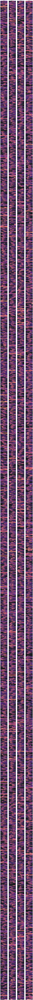

In [4]:
fig = plt.figure(figsize=(16, 500))
for i, j in enumerate(train_data):
    if i < 5236:
        ax = fig.add_subplot(size/4, 4, i+1)
        librosa.display.specshow(j)
        plt.title(str(i)+'('+ str(samples_dif[i]) +')')
    else:
        break